In [1]:
import numpy as np
import pandas as pd
import yfinance as yf
import riskfolio as rp
import warnings

warnings.filterwarnings("ignore")

yf.pdr_override()

# Date range
start = '2014-01-01'
end = '2024-12-30'

# Tickers of assets
tickers = [
    'SPY',  # 미국 주식
    'IEV',  # 유럽 주식 
    'EWJ',  # 일본 주식
    # 'EEM',  # 이머징 주식
    'TLT',  # 미국 장기채
    'IEF',  # 미국 중기채
    'SHY',  # 미국 단기채
    'IYR',  # 미국 리츠
    'RWX',  # 글로벌 리츠
    'GLD',  # 금
    'DBC',  # 상품
    'INDA', # 인도 주식
    'EWY', # kospi
]
exrate = ['USDKRW=X']
downloads = tickers + exrate
downloads.sort()

# Downloading the data
data = yf.download(downloads, start=start, end=end)

# Adjust Close 데이터 추출
data_adj_close = data.loc[:, ('Adj Close', slice(None))]
data_adj_close.columns = data_adj_close.columns.droplevel(0)

# 환율 데이터 추출
exrate_data = data_adj_close['USDKRW=X']

# 자산 가격 데이터를 원화로 변환
assets_krw = data_adj_close[tickers].multiply(exrate_data, axis=0)

# 일일 수익률 계산
assets = assets_krw.pct_change().dropna()


[*********************100%%**********************]  13 of 13 completed


In [2]:
Y = assets

# Creating the Portfolio Object
port = rp.Portfolio(returns=Y)

# To display dataframes values in percentage format
pd.options.display.float_format = '{:.4%}'.format


# Estimate inputs of the model (historical estimates)
method_mu='hist' # Method to estimate expected returns based on historical data.
method_cov='hist' # Method to estimate covariance matrix based on historical data.

port.assets_stats(method_mu=method_mu, method_cov=method_cov)



In [3]:
from timeit import default_timer as timer
from datetime import timedelta

# rms = ['MV', 'MAD', 'MSV', 'FLPM', 'SLPM', 'CVaR',
#        'EVaR', 'WR', 'MDD', 'ADD', 'CDaR', 'UCI', 'EDaR']

rms = ['MV', 
       #'KT', 
       'MAD', 
       # 'GMD', 
       'MSV', 
       # 'SKT', 
       'FLPM', 
       'SLPM', 
       'CVaR', 
       # 'TG', 
       'EVaR', 
       'RLVaR', 
       'WR', 
       # 'CVRG', 
       # 'TGRG', 
       # 'RG', 
       'MDD', # 1 
       'ADD', 
       # 'DaR', 
       # 'CDaR', 
       # 'EDaR', 
       # 'RLDaR', 
       'UCI'
       ]

for rm in rms:
       start = timer()
       
       port.sht = True # Allows to use Short Weights 숏 포지션(공매도)을 허용하도록 설정합니다.

       port.uppersht = 0.3 # 숏 포지션의 합이 절대값으로 최대 30%가 되도록 설정합니다.
       port.upperlng = 1.3 # 롱 포지션의 합이 최대 130%가 되도록 설정합니다.
       port.budget = 1.0 # port.upperlng - port.uppersht 롱 포지션과 숏 포지션의 합이 100%가 되도록 설정합니다

       # Choose the risk measure
       model = 'Classic'
       obj = 'Sharpe'
       # obj = 'MinRisk'
       # obj = 'Utility'
       rf = 0
       b = None
       hist = True
       l = 0

       # Estimate the portfolio that maximizes the risk adjusted return ratio
       w = port.optimization(model=model, rm=rm, obj=obj, rf=0.0, l=0, hist=True)
       # w = port.rp_optimization(model=model, rm='MV', rf=rf, b=b, hist=hist)
       # w = port.rrp_optimization(model=model, version="C", l=1, b=None, hist=hist)

       ax = rp.jupyter_report(returns=Y,
                            w=w,
                            rm=rm,
                            rf=0,
                            alpha=0.05,
                            height=6,
                            width=14,
                            others=0.05,
                            solver='MOSEK',
                            nrow=25)

       end = timer()
       print(rm + ' takes ',timedelta(seconds=end-start))

MV takes  0:00:04.853717
MAD takes  0:00:04.435193
MSV takes  0:00:04.521767
FLPM takes  0:00:04.614307
SLPM takes  0:00:04.705945
CVaR takes  0:00:04.589584
EVaR takes  0:00:08.017233


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


MV takes  0:00:13.506397


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


MAD takes  0:00:13.289104


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


MSV takes  0:00:13.220215


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


FLPM takes  0:00:13.584746


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


SLPM takes  0:00:13.537849


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


CVaR takes  0:00:15.937316


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


EVaR takes  0:00:18.277342


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


RLVaR takes  0:00:30.626834


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


WR takes  0:00:14.182796


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


MDD takes  0:00:13.697965


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


ADD takes  0:00:14.161074


,weights
SPY,14.7378%
IEV,5.6553%
EWJ,6.9232%
TLT,6.7293%
IEF,14.5107%
SHY,18.3029%
IYR,6.9515%
RWX,2.1706%
GLD,13.3196%
DBC,2.6703%


UCI takes  0:00:13.880175


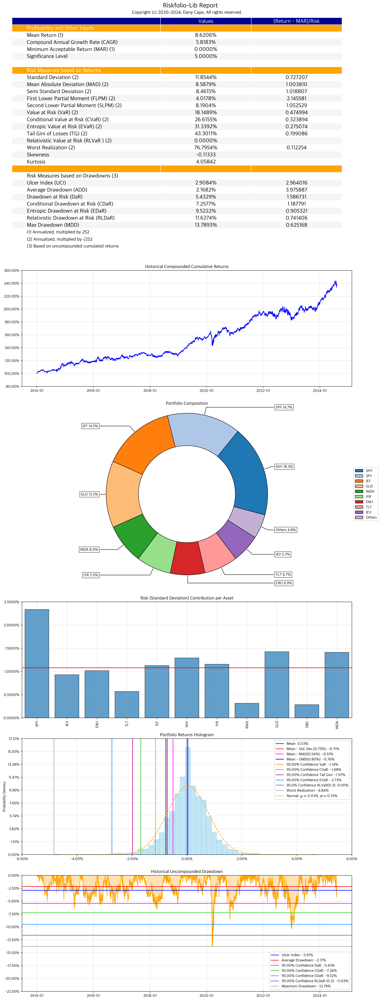

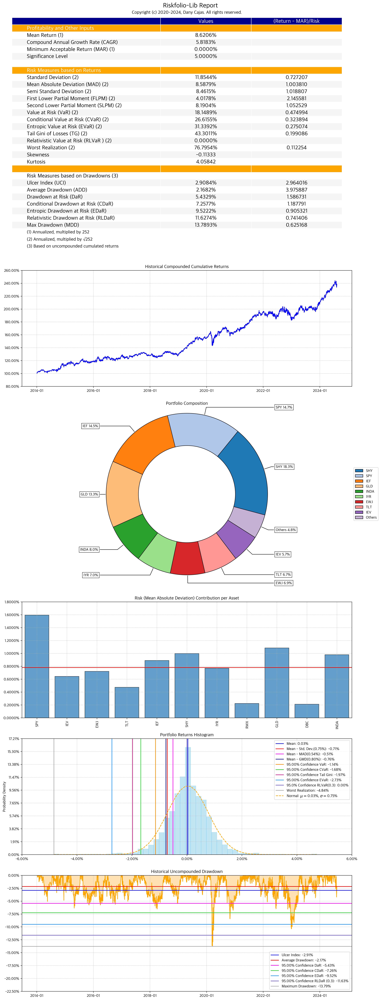

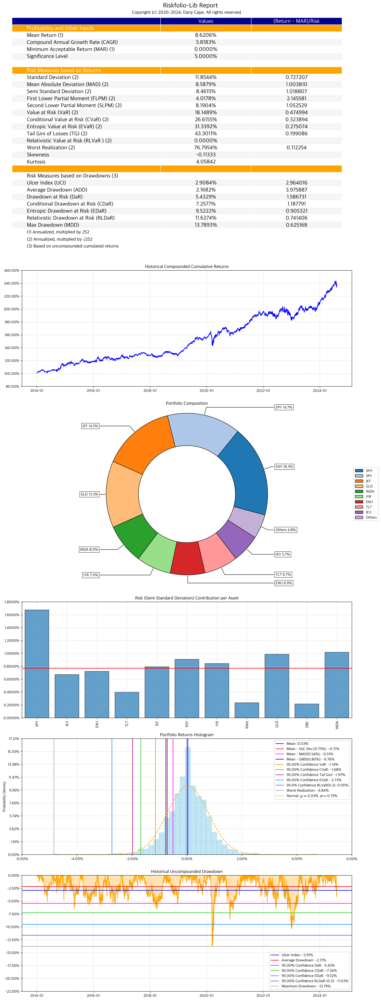

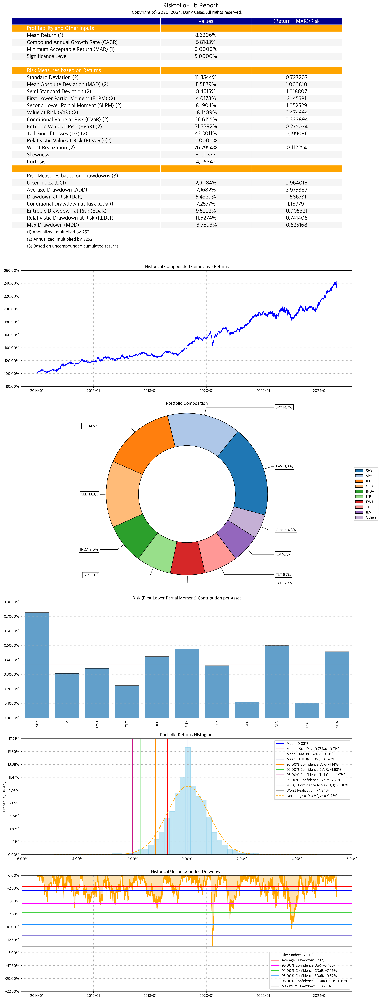

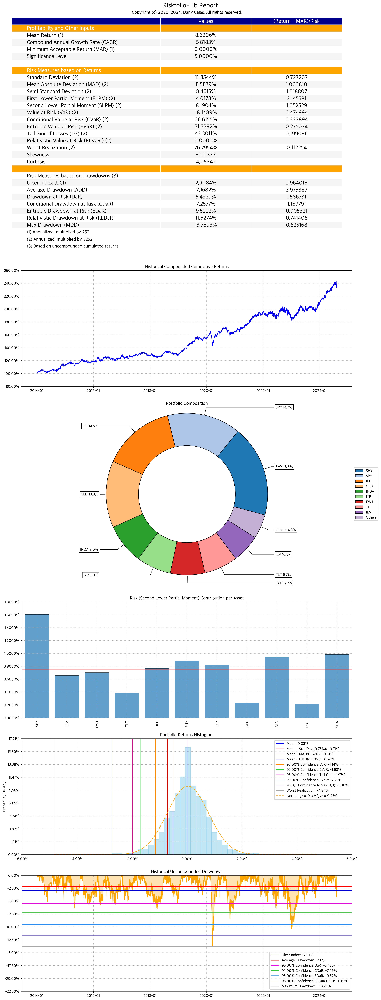

...

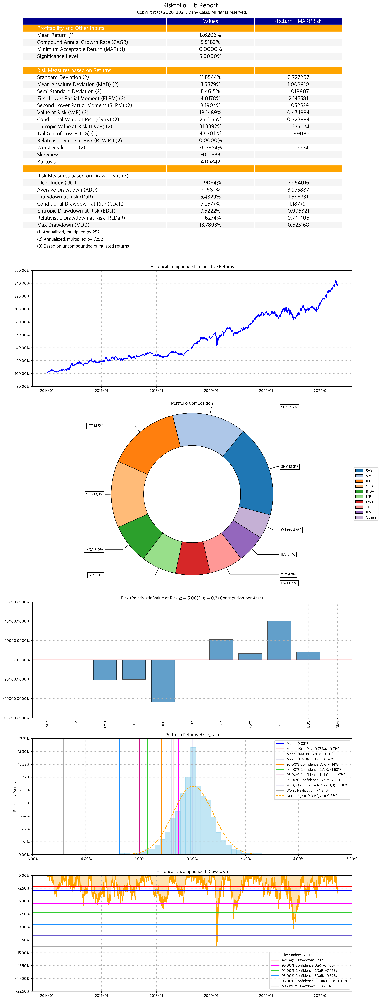

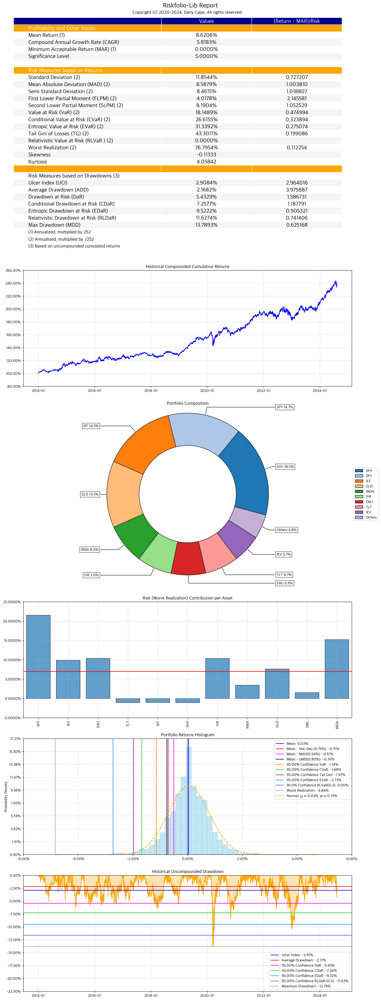

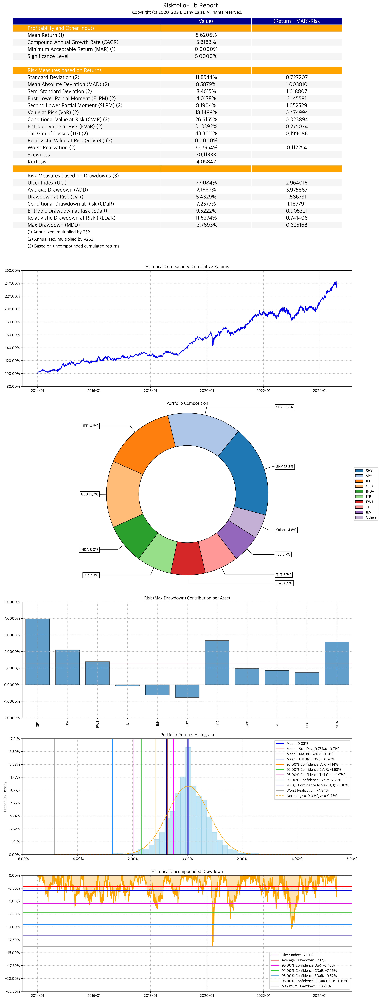

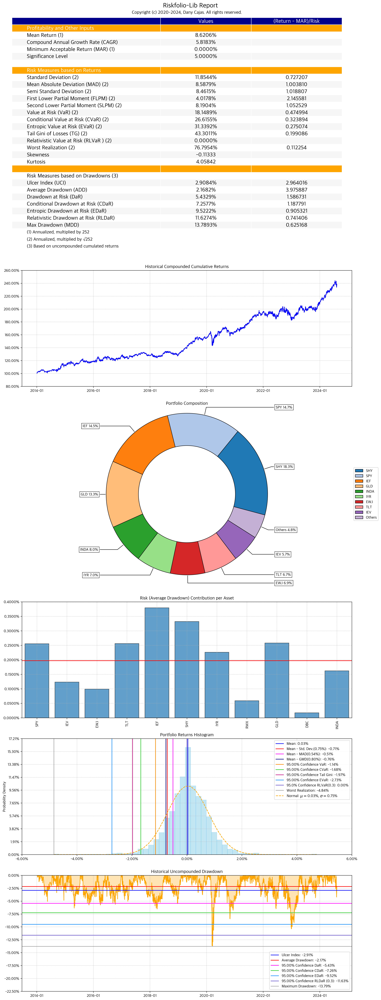

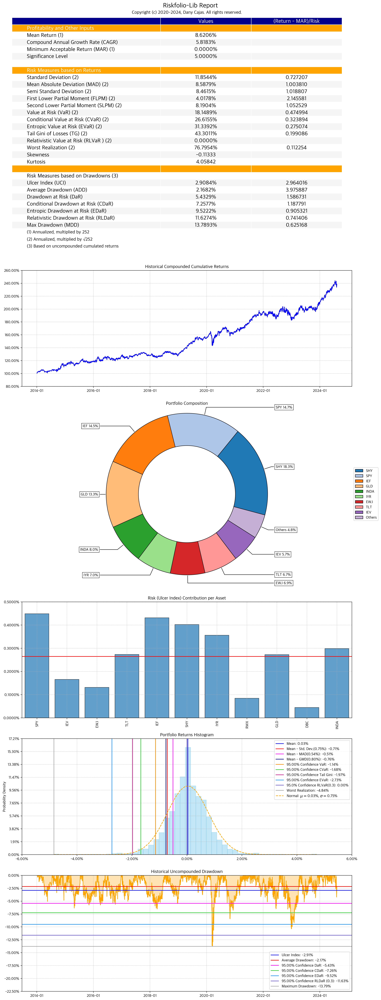

In [6]:
from timeit import default_timer as timer
from datetime import timedelta

# rms = ['MV', 'MAD', 'MSV', 'FLPM', 'SLPM', 'CVaR',
#        'EVaR', 'WR', 'MDD', 'ADD', 'CDaR', 'UCI', 'EDaR']

rms = ['MV', 
       #'KT', 
       'MAD', 
       # 'GMD', 
       'MSV', 
       # 'SKT', 
       'FLPM', 
       'SLPM', 
       'CVaR', 
       # 'TG', 
       'EVaR', 
       'RLVaR', 
       'WR', 
       # 'CVRG', 
       # 'TGRG', 
       # 'RG', 
       'MDD', # 1 
       'ADD', 
       # 'DaR', 
       # 'CDaR', 
       # 'EDaR', 
       # 'RLDaR', 
       'UCI'
       ]

for rm in rms:
       
       start = timer()
       
       # Choose the risk measure
       model = 'Classic'
       obj = 'Sharpe'
       # obj = 'MinRisk'
       # obj = 'Utility'
       rf = 0
       b = None
       hist = True
       l = 0

       box = 'm' # Method to estimate box uncertainty sets parameters
       ellip = 'm' # Method to estimate elliptical uncertainty sets parameters
       q = 0.05 # Confidence level for bootstrapping and k ellipsoidal uncertainty sets constraints
       n_sim = 3000 # Number of scenarios for bootstrapping
       window = 3 # Size of each block for block bootstrapping
       dmu = 0.1 # delta to increase or decrease the mean vector
       dcov = 0.1 # delta to increase or decrease the covariance matrix
       seed = 0

       port.wc_stats(box=box, ellip=ellip, q=q, n_sim=n_sim, window=window, dmu=dmu, dcov=dcov, seed=seed)

       # Estimate worst case optimal portfolio using selected uncertainty sets:
       port.solvers = ['MOSEK']

       Umu = 'ellip' # Type of uncertainty set for mean vector
       Ucov = 'ellip' # Type of uncertaity set for covariance matrix

       w = port.wc_optimization(obj=obj, rf=rf, l=l, Umu=Umu, Ucov=Ucov)

       display(w)

       ax = rp.jupyter_report(returns=Y,
                            w=w,
                            rm=rm,
                            rf=0,
                            alpha=0.05,
                            height=6,
                            width=14,
                            others=0.05,
                            nrow=25)
       
       end = timer()
       print(rm + ' takes ',timedelta(seconds=end-start))
       

In [5]:
box = 'd' # Method to estimate box uncertainty sets parameters
ellip = 's' # Method to estimate elliptical uncertainty sets parameters
q = 0.05 # Confidence level for bootstrapping and k ellipsoidal uncertainty sets constraints
n_sim = 3000 # Number of scenarios for bootstrapping
window = 3 # Size of each block for block bootstrapping
dmu = 0.1 # delta to increase or decrease the mean vector
dcov = 0.1 # delta to increase or decrease the covariance matrix
seed = 0

port.wc_stats(box=box, ellip=ellip, q=q, n_sim=n_sim, window=window, dmu=dmu, dcov=dcov, seed=seed)

# Estimate worst case optimal portfolio using selected uncertainty sets:

Umu = 'box' # Type of uncertainty set for mean vector
Ucov = 'box' # Type of uncertainty set for covariance matrix

w_wc_2 = port.wc_optimization(obj=obj, rf=rf, l=l, Umu=Umu, Ucov=Ucov)